# Necessary imports

In [43]:
import os
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as T
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
%matplotlib inline
import torch.nn as nn
from torchvision.utils import save_image
from tqdm.notebook import tqdm
import torch.nn.functional as F
import matplotlib as plt

# Loading The Dataset

In [2]:
DATA_DIR = '../input/animefacedataset/'

In [3]:
print(os.listdir(DATA_DIR))

['images']


In [5]:
image_size = 64
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

In [6]:
train_ds = ImageFolder(DATA_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*stats)]))

train_dl = DataLoader(train_ds, batch_size, shuffle=True, num_workers=3, pin_memory=True)

In [7]:
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

# Plotting Images Batch

In [8]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

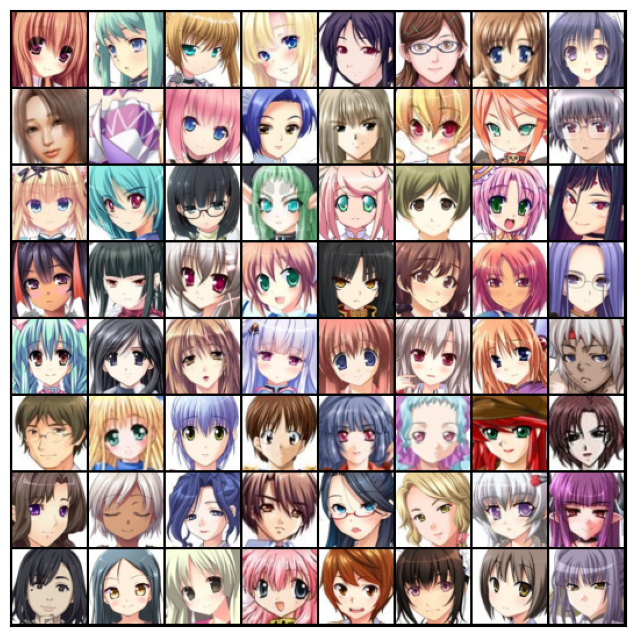

In [11]:
show_batch(train_dl)

# Using GPU

In [12]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [13]:
device = get_default_device()
device

device(type='cuda')

In [14]:
train_dl = DeviceDataLoader(train_dl, device)

# Discriminator's Architecture

In [16]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

In [17]:
discriminator = to_device(discriminator, device)

In [18]:
latent_size = 128

# Generator's Architecture

In [19]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
)

torch.Size([128, 3, 64, 64])


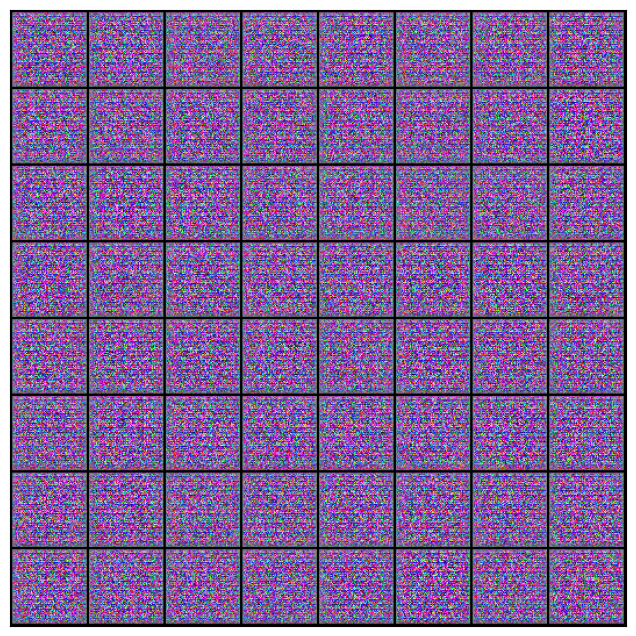

In [20]:
xb = torch.randn(batch_size, latent_size, 1, 1) # random latent tensors
fake_images = generator(xb)
print(fake_images.shape)
show_images(fake_images)

In [21]:
generator = to_device(generator, device)

# Train Discriminator

In [22]:
def train_discriminator(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

# Train Generator

In [23]:
def train_generator(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)
    
    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = F.binary_cross_entropy(preds, targets)
    
    # Update generator weights
    loss.backward()
    opt_g.step()
    
    return loss.item()

In [26]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [27]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))

In [28]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

Saving generated-images-0000.png


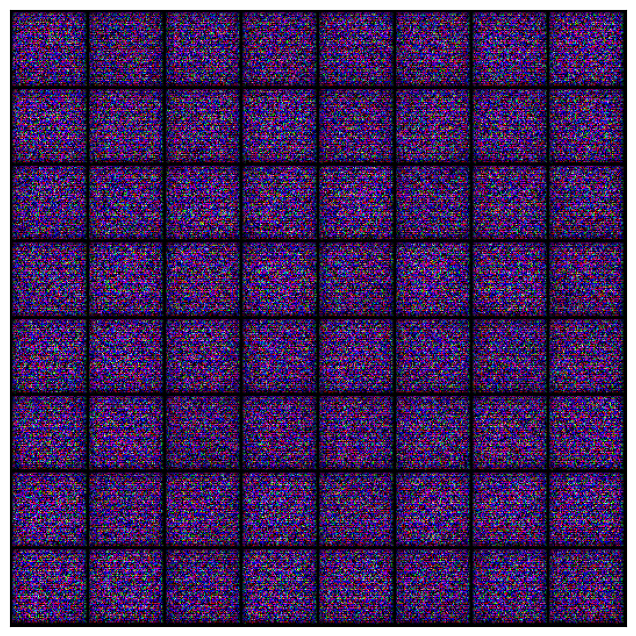

In [29]:
save_samples(0, fixed_latent)

# Fitting the Model

In [36]:
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    
    for epoch in range(epochs):
        for real_images, _ in tqdm(train_dl):
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            # Train generator
            loss_g = train_generator(opt_g)
            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # Save and show generated images
        generated_images = generator(fixed_latent).detach().cpu()
        save_samples(epoch+start_idx, fixed_latent, show=False)  # Save the images
        plt.figure(figsize=(10, 10))
        for i in range(25):  # Assuming you want to show 25 images in a grid
            plt.subplot(5, 5, i+1)
            plt.imshow(generated_images[i].permute(1, 2, 0))  # Assuming images are in CHW format
            plt.axis('off')
        plt.show()  # Show the images
    
    return losses_g, losses_d, real_scores, fake_scores


In [37]:
lr = 0.0002
epochs = 25

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [1/25], loss_g: 15.2789, loss_d: 0.6382, real_score: 0.9993, fake_score: 0.3918
Saving generated-images-0001.png


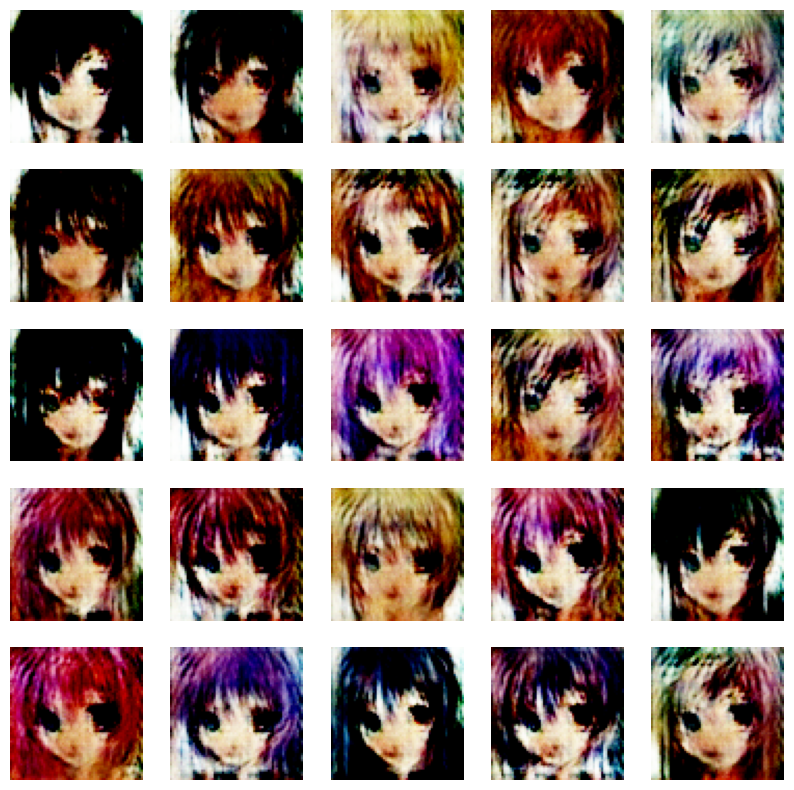

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [2/25], loss_g: 6.3735, loss_d: 0.0832, real_score: 0.9467, fake_score: 0.0083
Saving generated-images-0002.png


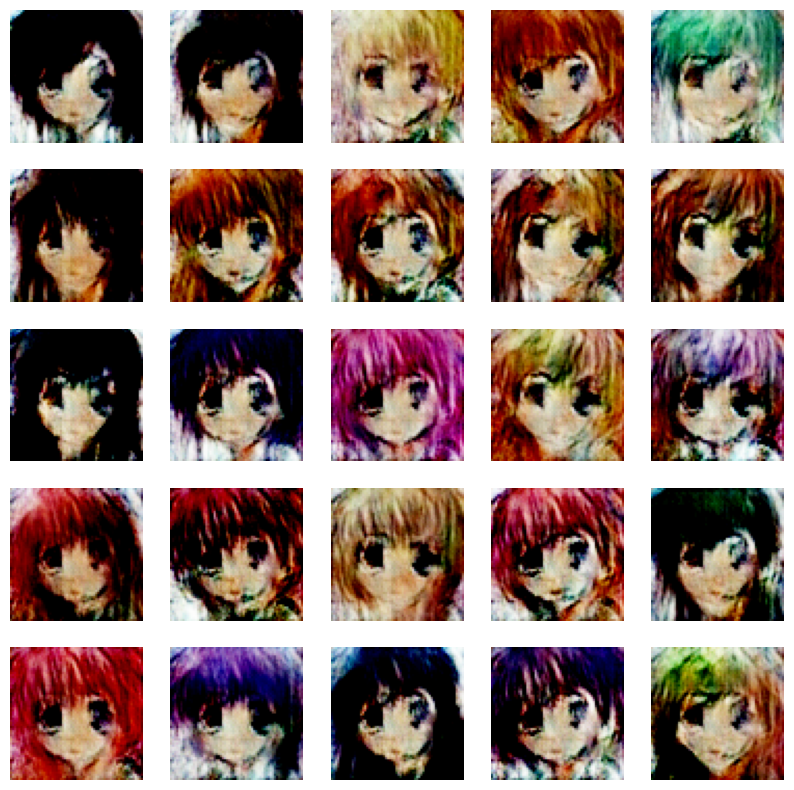

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [3/25], loss_g: 16.8353, loss_d: 1.6301, real_score: 0.9999, fake_score: 0.6074
Saving generated-images-0003.png


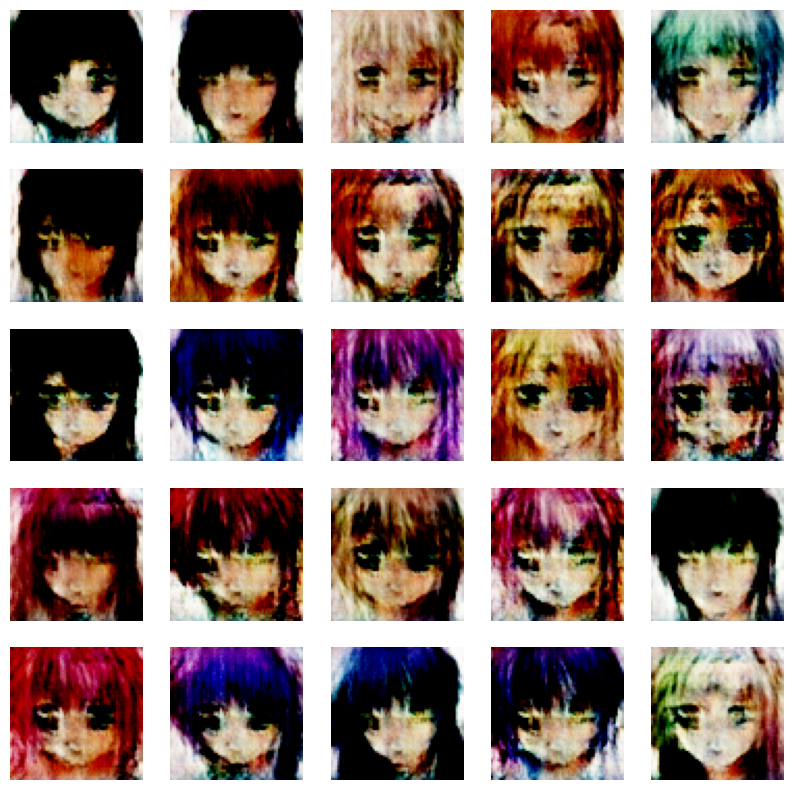

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [4/25], loss_g: 9.9395, loss_d: 0.0352, real_score: 0.9686, fake_score: 0.0006
Saving generated-images-0004.png


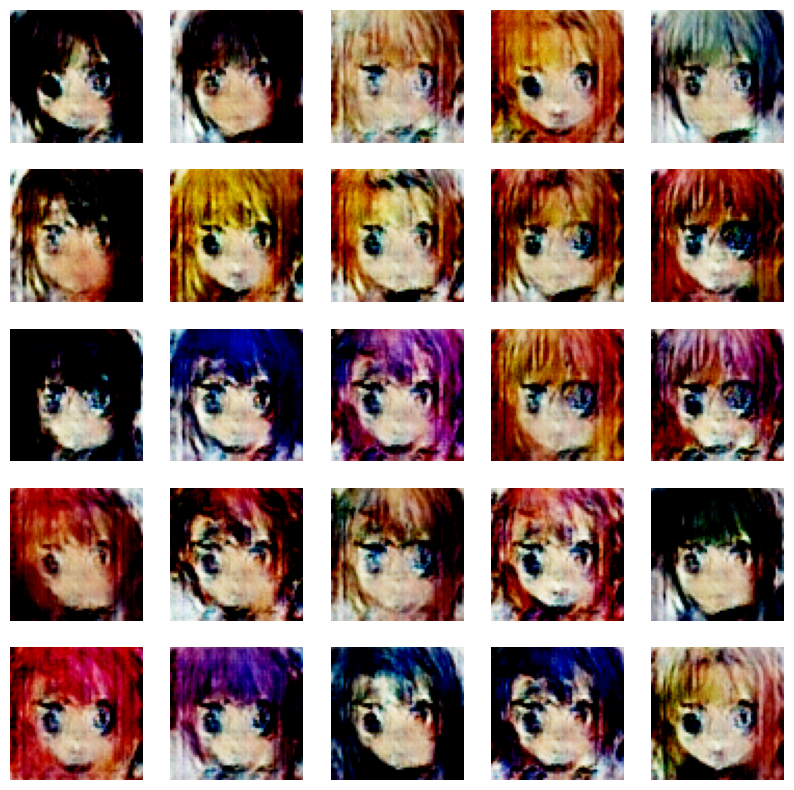

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [5/25], loss_g: 9.3337, loss_d: 0.1303, real_score: 0.9865, fake_score: 0.0987
Saving generated-images-0005.png


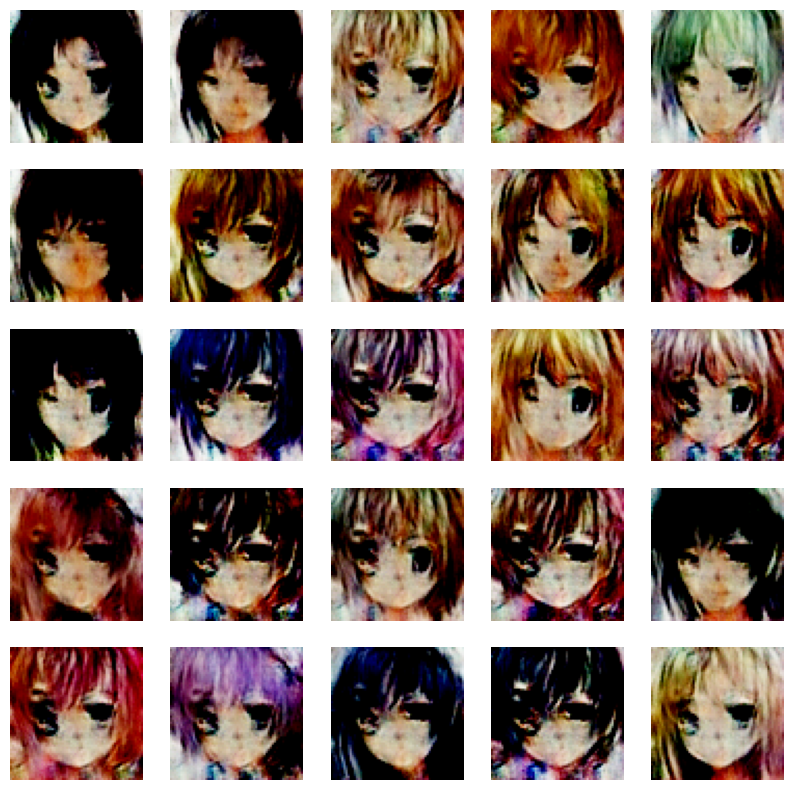

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [6/25], loss_g: 9.7378, loss_d: 0.0121, real_score: 0.9902, fake_score: 0.0019
Saving generated-images-0006.png


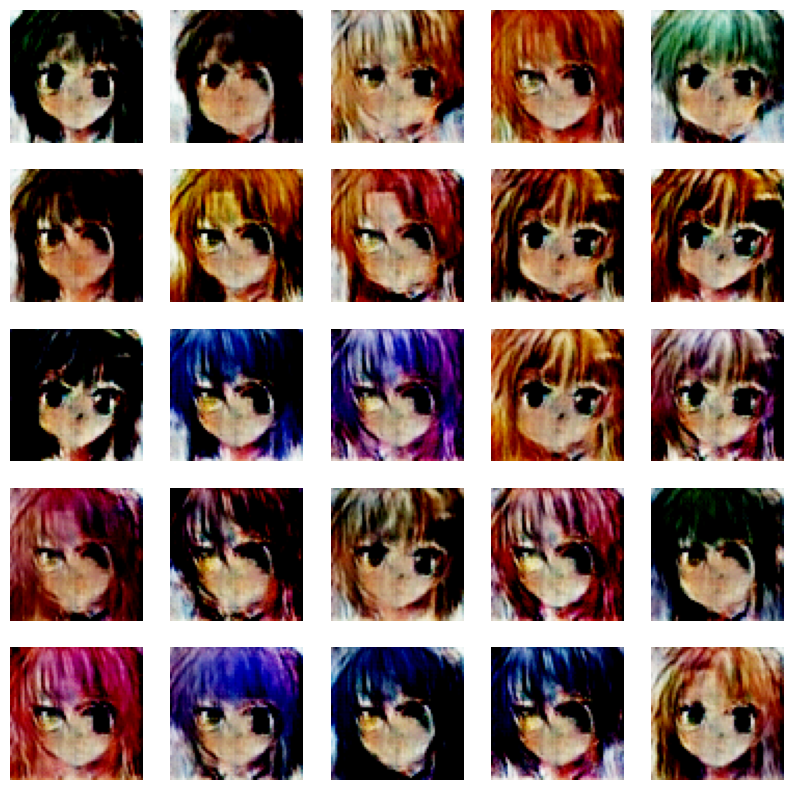

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [7/25], loss_g: 7.7324, loss_d: 0.0524, real_score: 0.9615, fake_score: 0.0032
Saving generated-images-0007.png


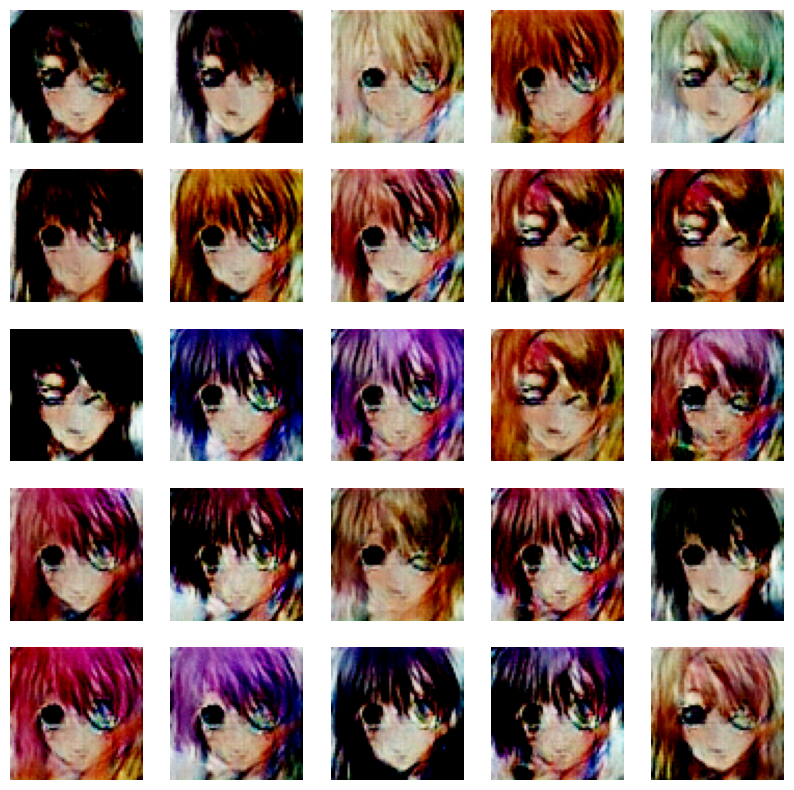

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [8/25], loss_g: 12.1633, loss_d: 0.3511, real_score: 0.7976, fake_score: 0.0000
Saving generated-images-0008.png


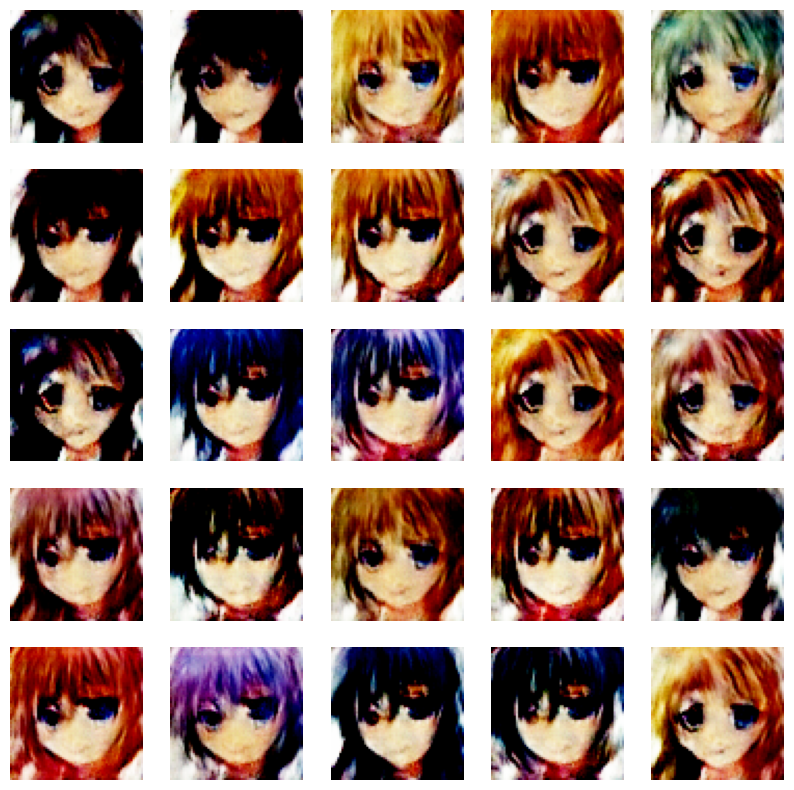

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [9/25], loss_g: 7.2217, loss_d: 0.1101, real_score: 0.9148, fake_score: 0.0005
Saving generated-images-0009.png


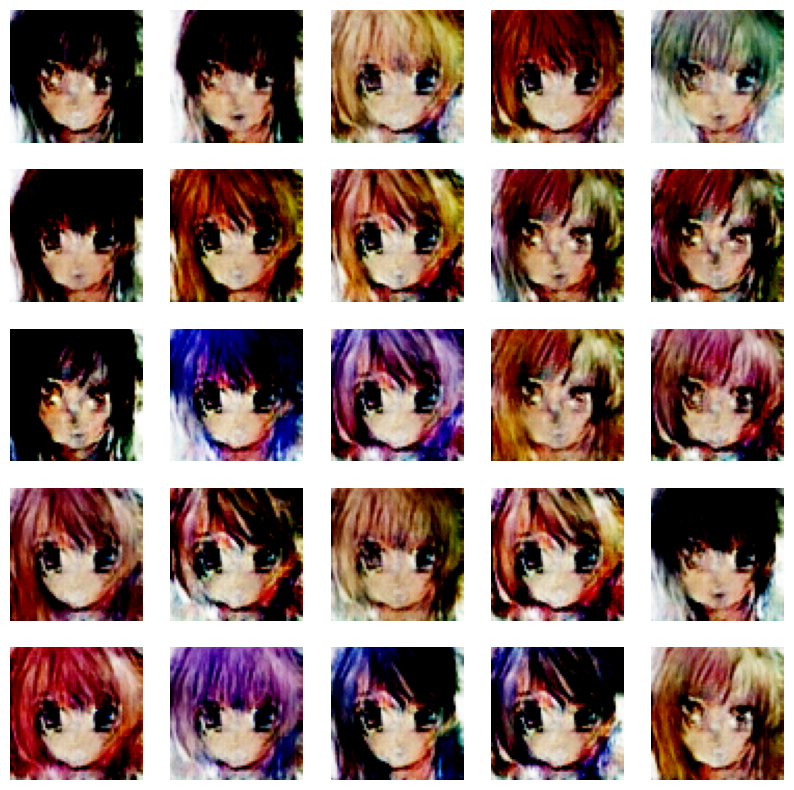

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [10/25], loss_g: 10.3206, loss_d: 0.1265, real_score: 0.9964, fake_score: 0.0993
Saving generated-images-0010.png


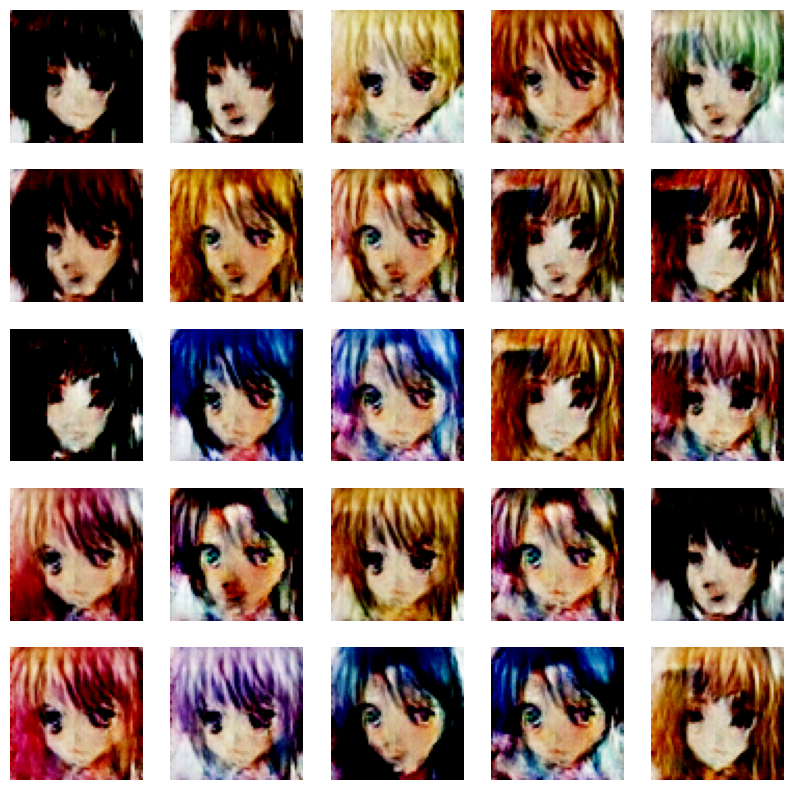

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [11/25], loss_g: 4.6545, loss_d: 0.0400, real_score: 0.9976, fake_score: 0.0336
Saving generated-images-0011.png


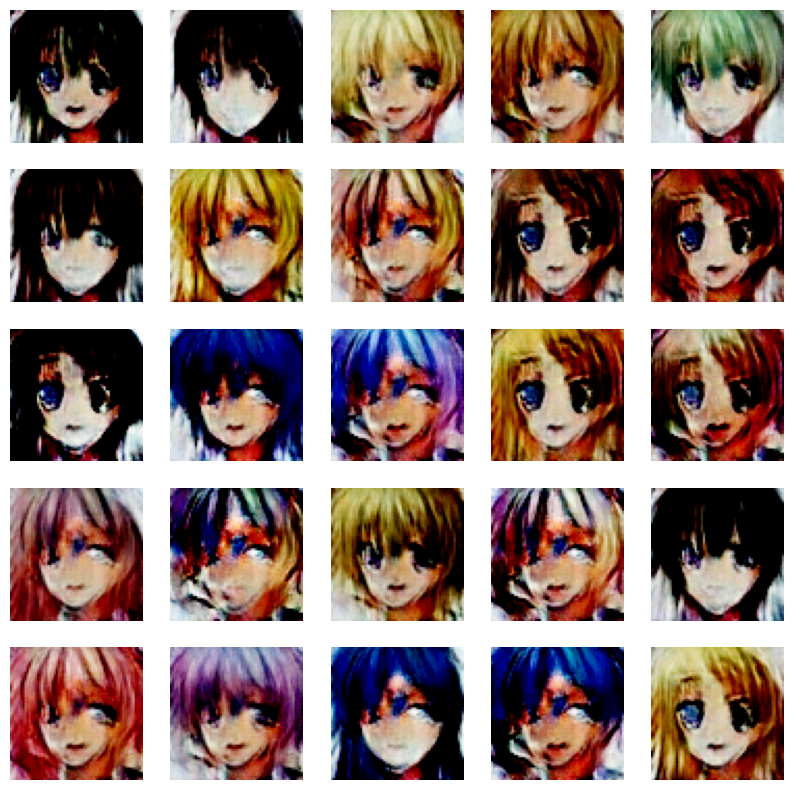

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [12/25], loss_g: 6.4868, loss_d: 0.0478, real_score: 0.9673, fake_score: 0.0098
Saving generated-images-0012.png


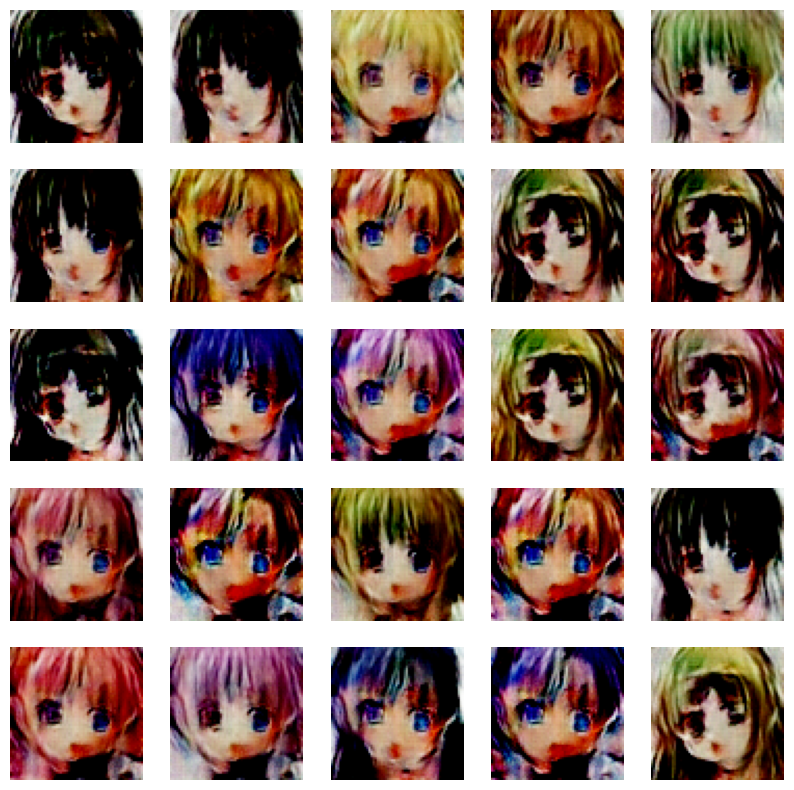

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [13/25], loss_g: 6.9464, loss_d: 0.0298, real_score: 0.9872, fake_score: 0.0148
Saving generated-images-0013.png


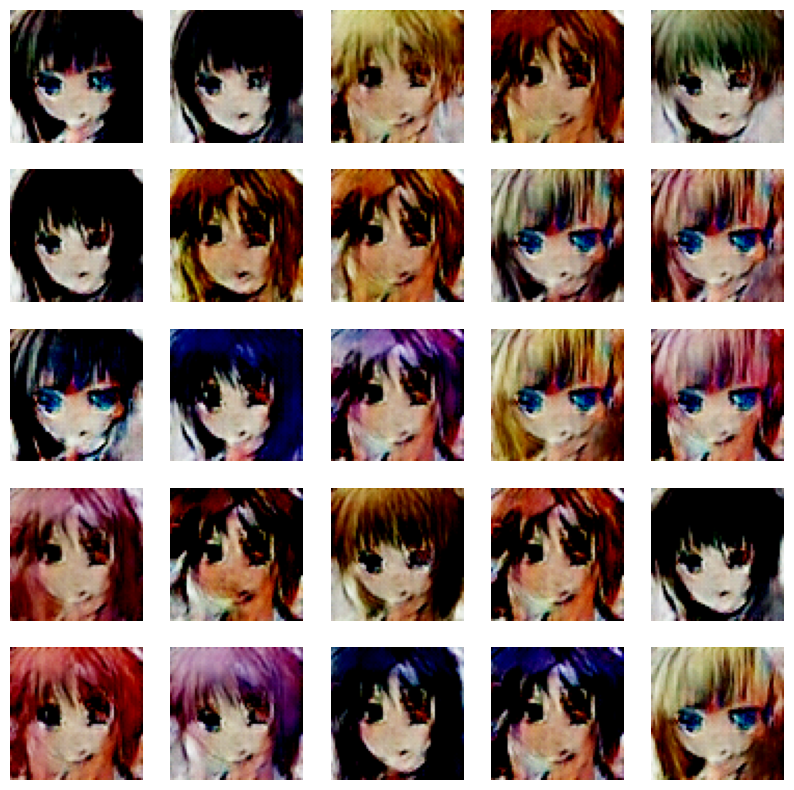

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [14/25], loss_g: 6.1172, loss_d: 4.3458, real_score: 0.1312, fake_score: 0.0000
Saving generated-images-0014.png


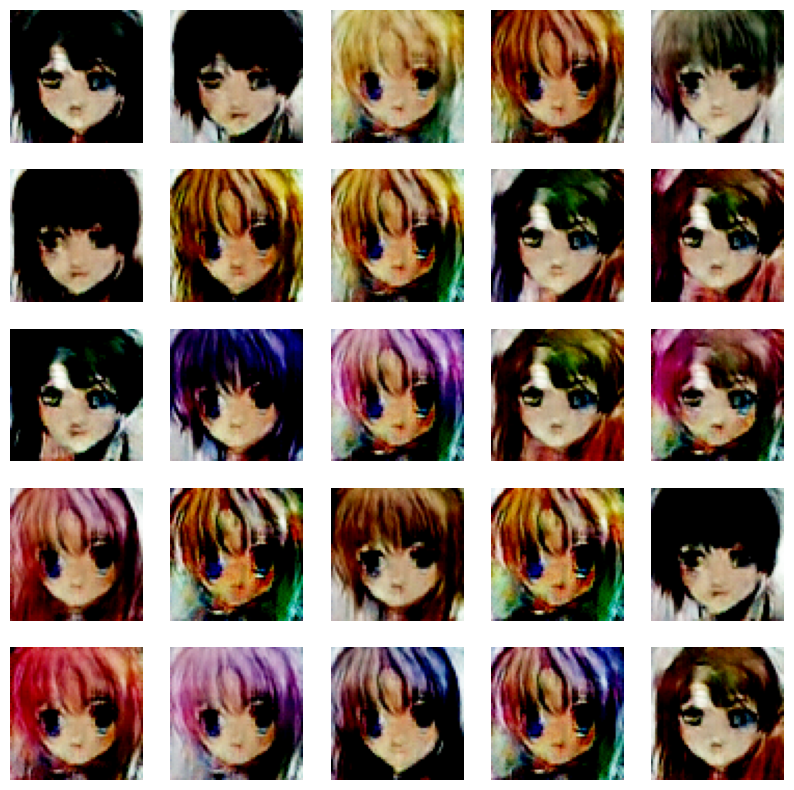

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [15/25], loss_g: 6.9890, loss_d: 0.1167, real_score: 0.9665, fake_score: 0.0725
Saving generated-images-0015.png


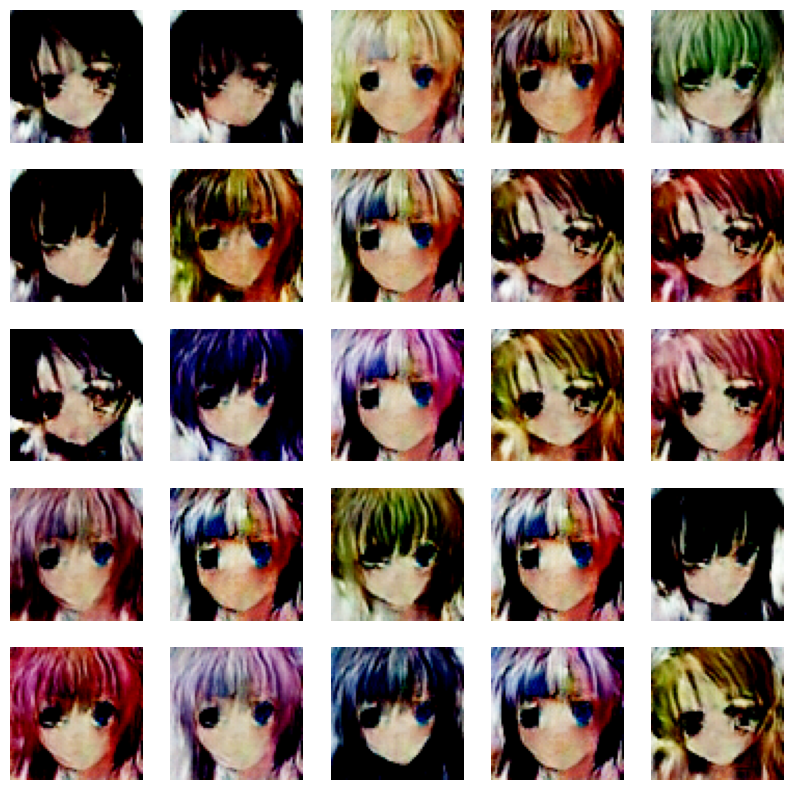

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [16/25], loss_g: 6.8293, loss_d: 0.0715, real_score: 0.9649, fake_score: 0.0271
Saving generated-images-0016.png


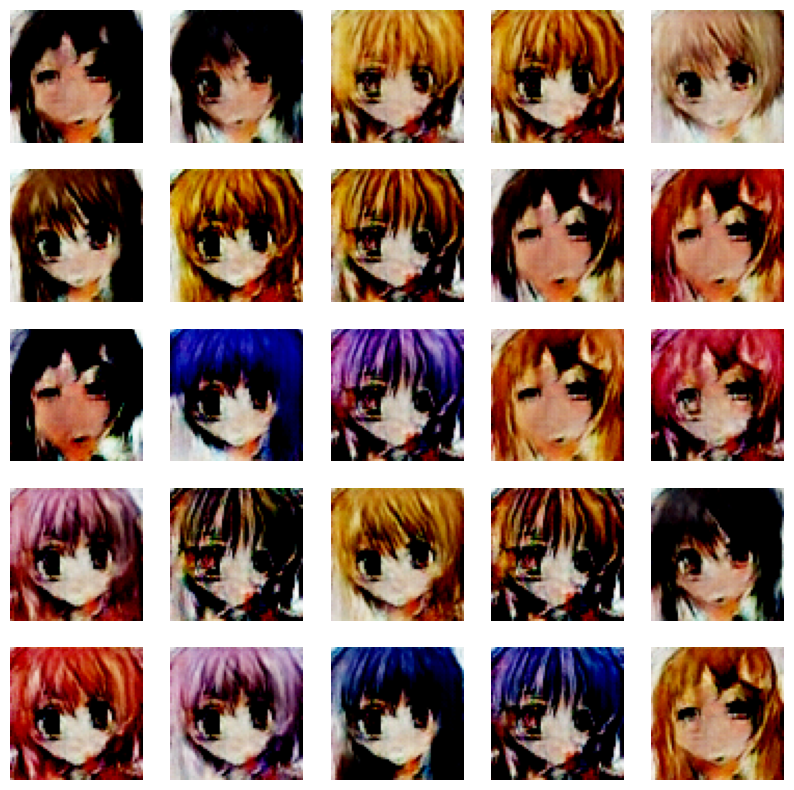

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [17/25], loss_g: 5.4097, loss_d: 0.0637, real_score: 0.9699, fake_score: 0.0273
Saving generated-images-0017.png


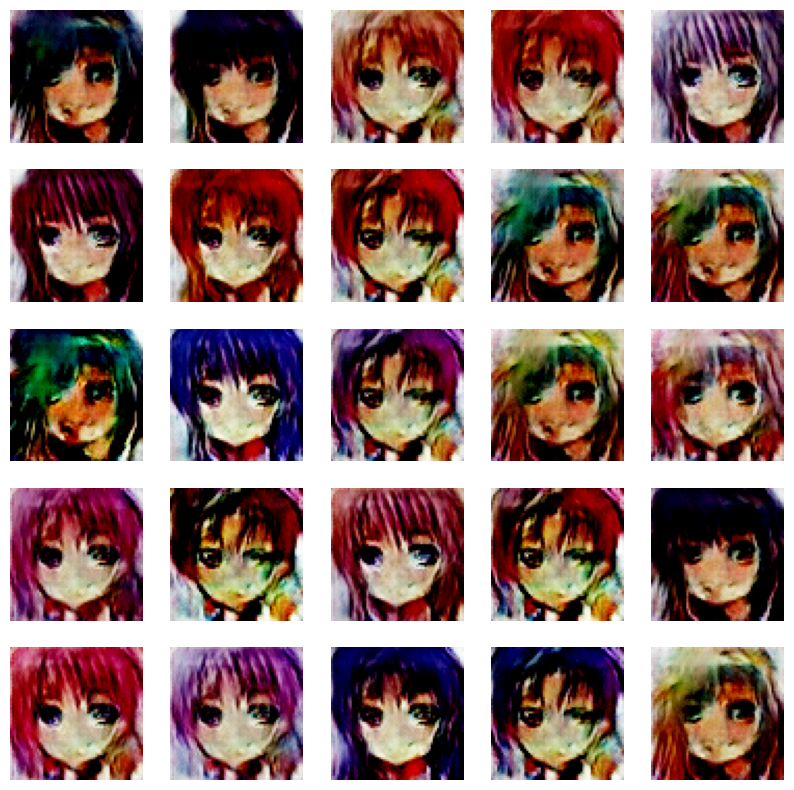

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [18/25], loss_g: 14.1281, loss_d: 0.0146, real_score: 0.9984, fake_score: 0.0124
Saving generated-images-0018.png


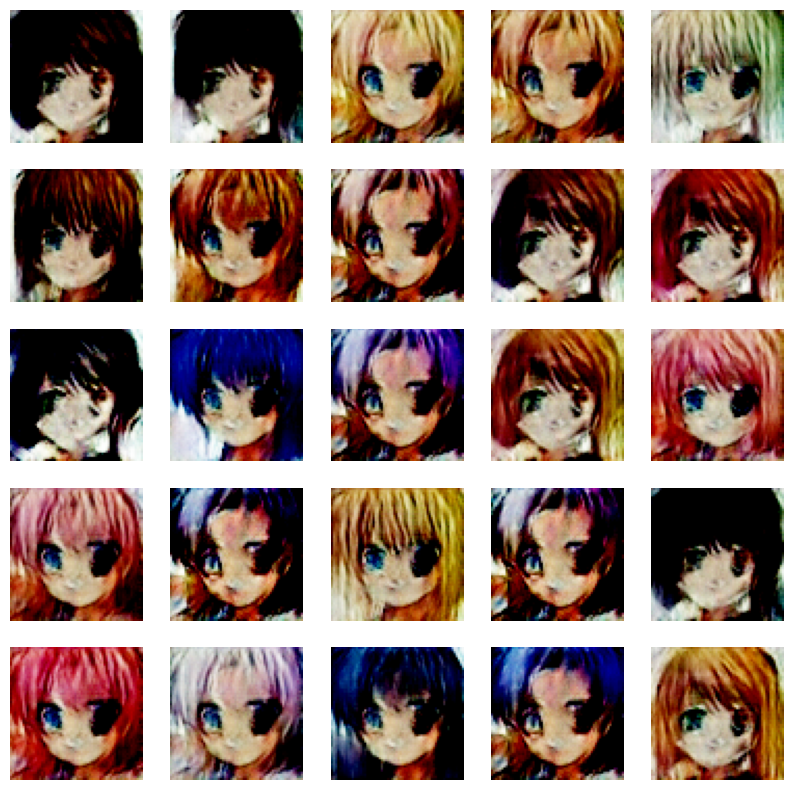

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [19/25], loss_g: 26.5919, loss_d: 1.6599, real_score: 1.0000, fake_score: 0.4852
Saving generated-images-0019.png


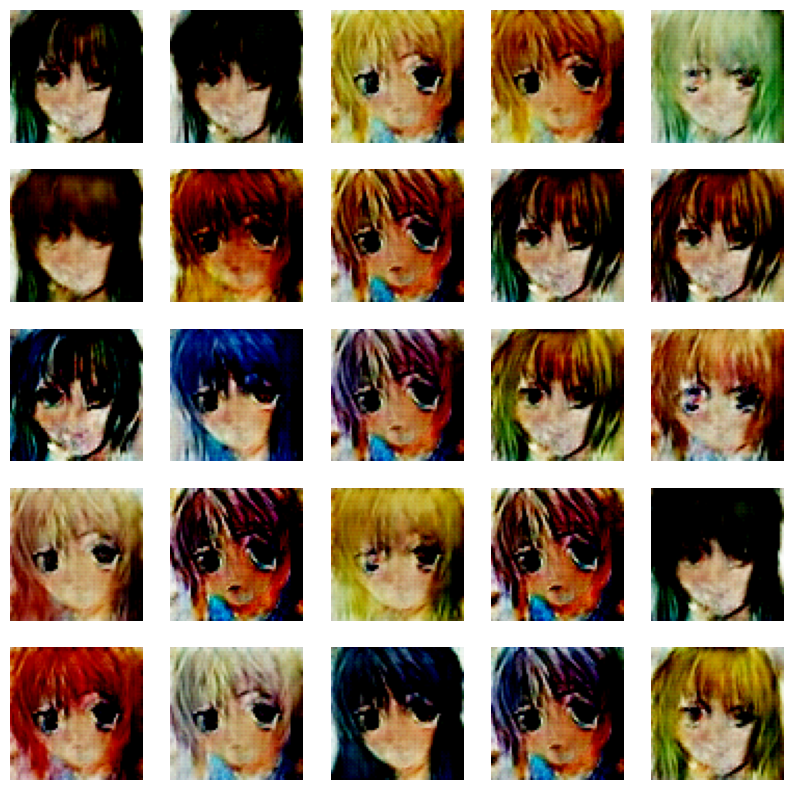

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [20/25], loss_g: 19.2598, loss_d: 0.0130, real_score: 0.9879, fake_score: 0.0003
Saving generated-images-0020.png


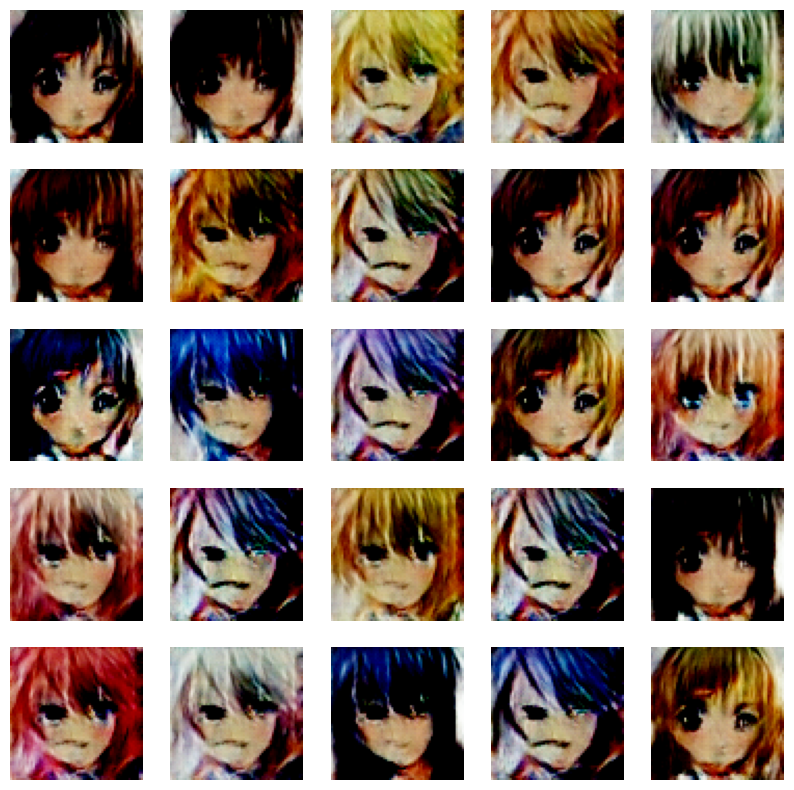

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [21/25], loss_g: 7.1782, loss_d: 0.0874, real_score: 0.9485, fake_score: 0.0165
Saving generated-images-0021.png


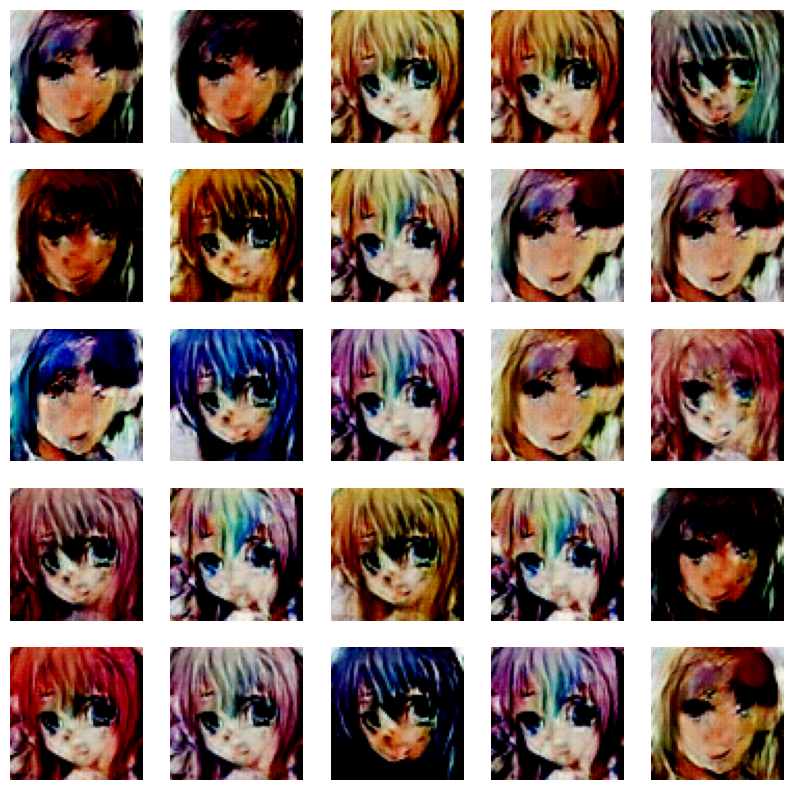

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [22/25], loss_g: 11.0919, loss_d: 0.5514, real_score: 0.7434, fake_score: 0.0001
Saving generated-images-0022.png


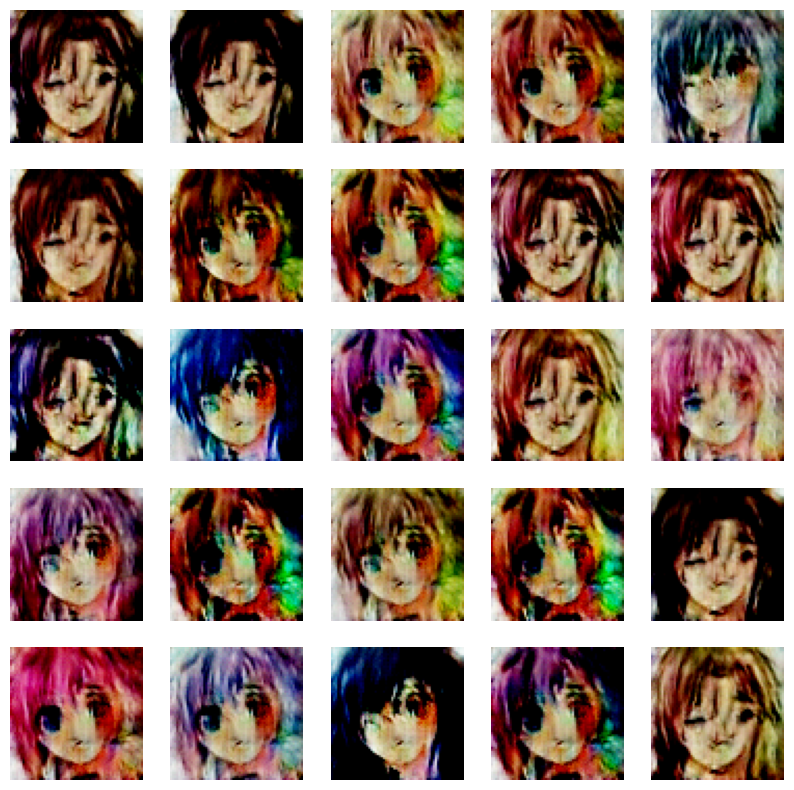

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [23/25], loss_g: 8.7013, loss_d: 0.0273, real_score: 0.9836, fake_score: 0.0085
Saving generated-images-0023.png


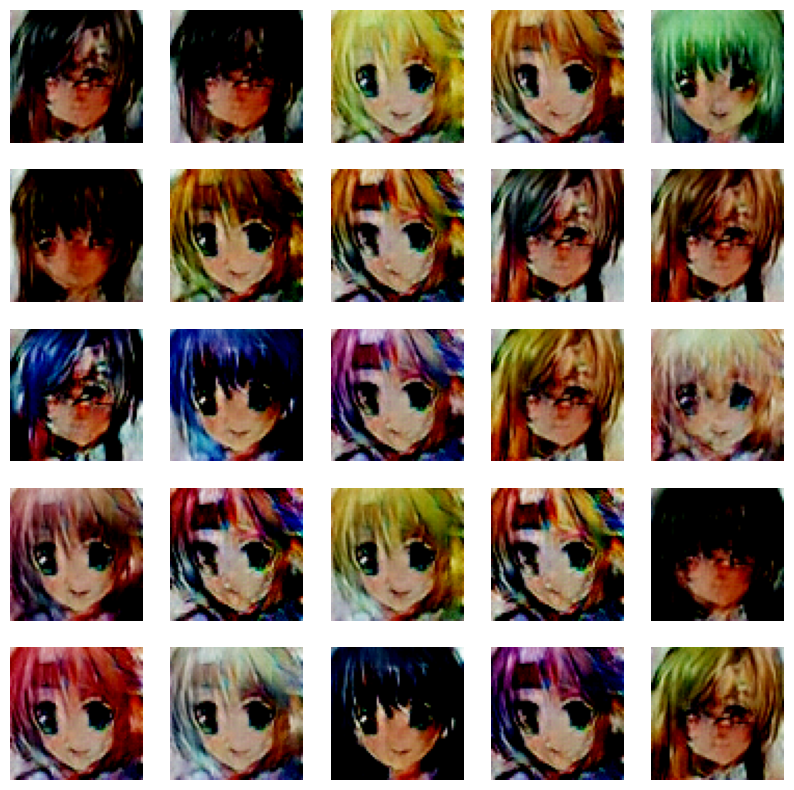

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [24/25], loss_g: 17.2680, loss_d: 0.0235, real_score: 0.9913, fake_score: 0.0133
Saving generated-images-0024.png


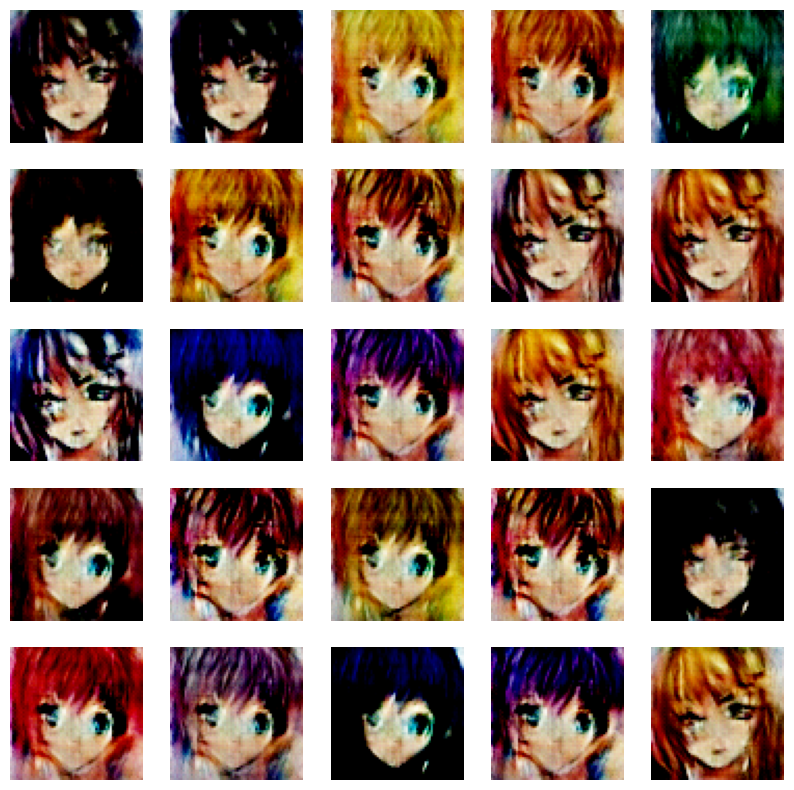

  0%|          | 0/497 [00:00<?, ?it/s]

Epoch [25/25], loss_g: 8.6092, loss_d: 0.1185, real_score: 0.9764, fake_score: 0.0856
Saving generated-images-0025.png


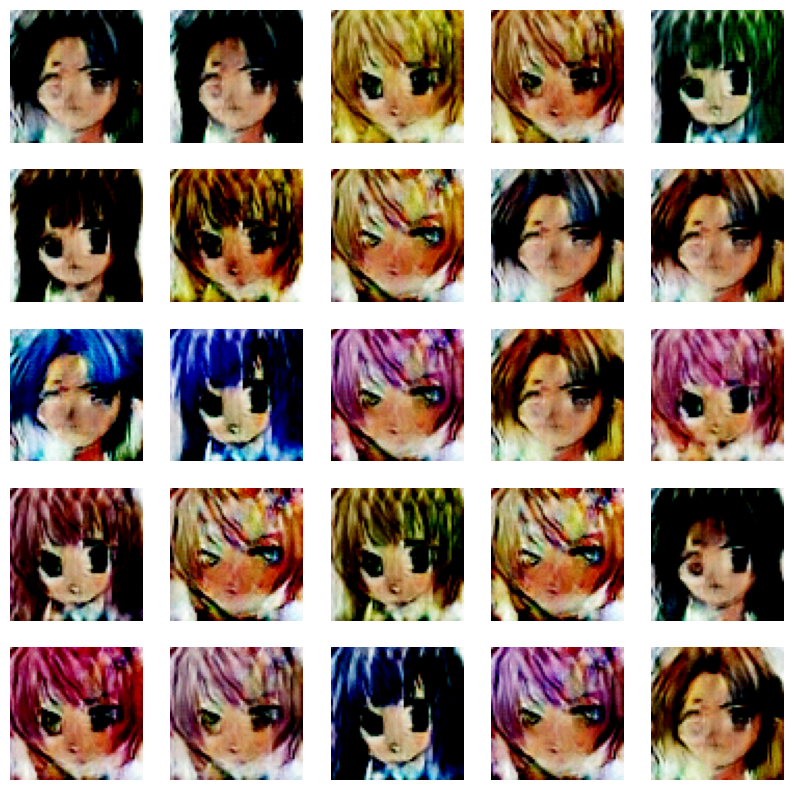

In [38]:
history = fit(epochs, lr)

In [40]:
losses_g, losses_d, real_scores, fake_scores = history

# Losses

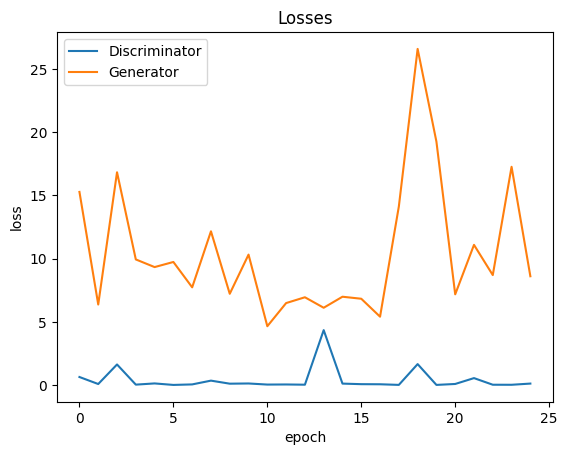

In [41]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

# Scores

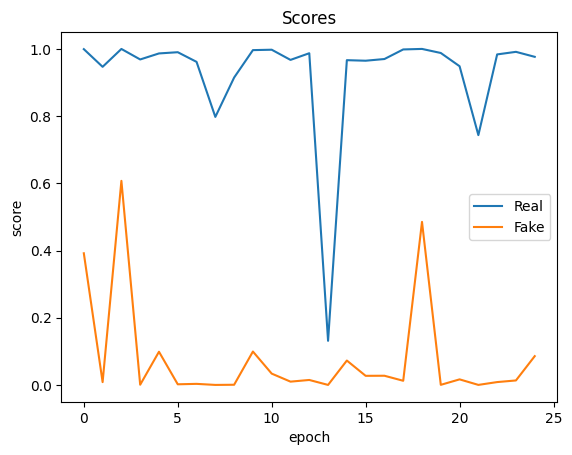

In [42]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

# Evaluation

## FID-Score

In [1]:
def calculate_activation_statistics(images, model):
    # Scale images to the range of [-1, 1]
    images = (images - 127.5) / 127.5
    # Resize images to 299x299 for Inception-v3 model
    images_resized = tf.image.resize(images, (299, 299))
    # Preprocess images for Inception-v3 model
    images_preprocessed = preprocess_input(images_resized)
    # Get activations of the last convolutional layer
    activations = model.predict(images_preprocessed)
    # Flatten the activations
    activations = activations.reshape(activations.shape[0], -1)
    # Calculate mean and covariance
    mean = np.mean(activations, axis=0)
    covariance = np.cov(activations, rowvar=False)
    return mean, covariance

def calculate_frechet_distance(mu1, sigma1, mu2, sigma2):
    # Calculate sum of squared differences between means
    ssdiff = np.sum((mu1 - mu2)**2)
    # Calculate square root of product of covariances
    covmean = sqrtm(sigma1.dot(sigma2))
    # Check and correct imaginary numbers from sqrtm
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    # Calculate FID score
    fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Initialize Inception-v3 model
inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

# Generate fake images
num_fake_images = 1000  # Adjust this based on your need
fake_noise = tf.random.normal(shape=(num_fake_images, LATENT_DIM))
fake_images = generator(fake_noise, training=False)
fake_images = (fake_images * 127.5) + 127.5  # Denormalize images

# Calculate statistics for real and fake images
real_mean, real_covariance = calculate_activation_statistics(train_images[:num_fake_images], inception_model)
fake_mean, fake_covariance = calculate_activation_statistics(fake_images, inception_model)


# Calculate FID Score
fid_score = calculate_fid(inception, real_images, generated_images)
print(f"FID score: {fid_score}")

FID score: 6.853321569257686e+17


## Reconstruction Loss

In [4]:
def calculate_reconstruction_loss(original_images, generated_images):
    # Scale images to the range of [-1, 1]
    original_images = (original_images - 127.5) / 127.5
    generated_images = (generated_images - 127.5) / 127.5
    # Calculate Mean Squared Error (MSE) loss
    reconstruction_loss = tf.reduce_mean(tf.square(original_images - generated_images))
    return reconstruction_loss
# Reconstruction Loss Calculation
reconstruction_loss = calculate_reconstruction_loss(train_images[:num_images], generated_images)
print(f"Reconstruction Loss:",{reconstruction_loss})

Reconstruction Loss: 3.8624172
